
#      What is a GAN?

GAN stands for Generative Adveserial network, which is type of deep learning which consist 2 models,
  1. Generator 
  2. Discriminator
 Generator takes random noise vector. and generate new samples ( we can give an example of image), while discriminator evaluate wether given image is real or fake (generated by generator) 

#      How does a GAN work?

To train GAN, you can use the following process
1.The generator takes in a random noise vector and generates a new data sample.
2.The discriminator evaluates the generated data sample and provides feedback to the generator.
3.The generator updates its parameters to produce better data samples that can fool the discriminator.
4. The discriminator updates its parameters to better distinguish between real and fake data samples.
5. Steps 1-4 are repeated for a number of iterations until the generator produces data samples that are indistinguishable from real data samples.

#       Mathematical formulas

1.The generator's loss function is given by:
L_G = -E[log(D(G(z)))]
where z is a noise vector that is fed into the generator, G(z) is the output of the generator, and D(.) is the discriminator. The generator tries to minimize this loss function


2. The discriminator's loss function is given by:
L_D = -E[log(D(x))] - E[log(1 - D(G(z)))]
where x is a real image from the dataset, G(z) is a fake image generated by the generator, and D(.) is the discriminator. The discriminator tries to maximize this loss function

3.The overall formula for GAN can be expressed as:

min_G max_D V(D, G) = E_x[log(D(x))] + E_z[log(1 - D(G(z)))]

where:

.G is the generator function that takes a random noise vector z as input and outputs a generated sample G(z)
.D is the discriminator function that takes a sample x as input and outputs a scalar value D(x) representing the probability that x comes from the real data distribution
.E_x denotes the expectation over the real data distribution
.E_z denotes the expectation over the random noise distribution
The objective of GAN is to find the optimal G and D that jointly minimize V(D, G). 



#     Application of GAN


1. Image generation : image resembles like original
2. video synthetis :such as sports highlights, cartoons, or music videos
3. Data augmentation: GANs can be used to augment a given dataset with new data samples that are similar but not identical to the original data samples.
4.Text generation: GANs can be used to generate new text that resembles a given corpus of text, such as news articles, tweets, or stories. 

In [1]:
# step 1 import libraries
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import numpy as np
import matplotlib.pyplot as plt

manual_seed = 42
torch.manual_seed(manual_seed)

# Define Device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
ngpu = 1  # number of GPUs available. Use 0 for CPU mode.


# Define Discriminator Network
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input is (nc) x 32 x 32
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 16 x 16
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 8 x 8
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 4 x 4
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Define Generator Network
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 4, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 4 x 4
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 8 x 8
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 16 x 16
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 32 x 32
        )

    def forward(self, input):
        return self.main(input)

# Define Hyperparameters
batch_size = 128
image_size = 32
nc = 3
nz = 100
ngf = 64
ndf = 64


In [2]:
import torchvision.datasets as datasets

# Load CIFAR-10 Dataset
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])
train_dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)


100%|██████████| 170498071/170498071 [00:11<00:00, 15110285.96it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data


#    Let us plot our dataset first , to see how they look like, after we will generate another images which looks like them

170498071/170498071 [==============================] - 11s 0us/step


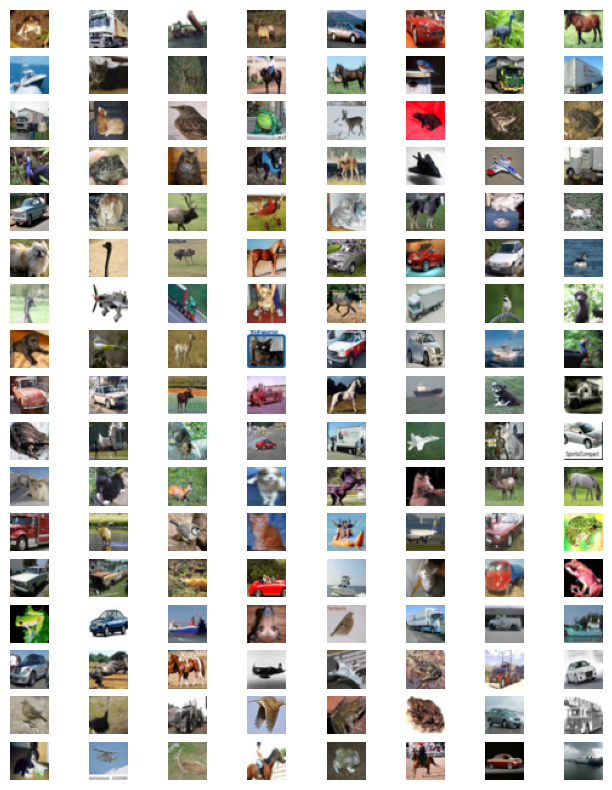

In [3]:
import matplotlib.pyplot as plt
import numpy as np
from keras.datasets import cifar10

# Load the CIFAR-10 dataset
(train_images, train_labels), (test_images, test_labels) = cifar10.load_data()

def show_images(images):
    # Create a figure with a 5x6 grid to plot 30 images
    fig = plt.figure(figsize=(8, 10))
    rows = 17
    cols = 8
    
    # Plot the images
    for i in range(rows*cols):
        if i < len(images):
            ax = fig.add_subplot(rows, cols, i+1)
            ax.imshow(images[i])
            ax.axis('off')
    
    plt.show()

# Display the images
show_images(train_images)


In [4]:
netD = Discriminator(ngpu).to(device)
netG = Generator(ngpu).to(device)

criterion = nn.BCELoss()

In [5]:
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
optimizerD = optim.Adam(netD.parameters(), lr=1e-6, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=1e-6, betas=(0.5, 0.999))



[0/5][0/391]	Loss_D: 1.3984	Loss_G: 0.8372	D(x): 0.4534	D(G(z)): 0.4407 / 0.4397


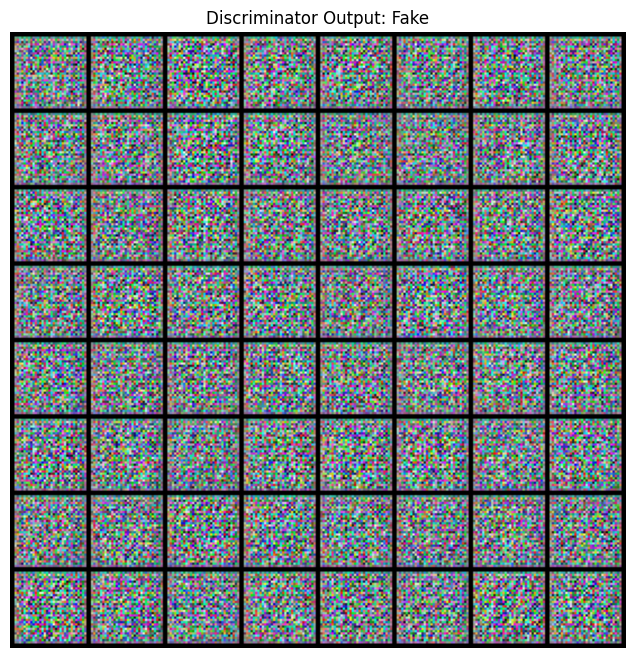

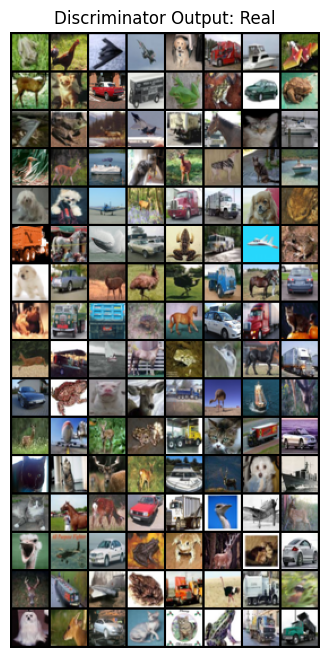

[0/5][100/391]	Loss_D: 1.2930	Loss_G: 0.8255	D(x): 0.5061	D(G(z)): 0.4460 / 0.4447


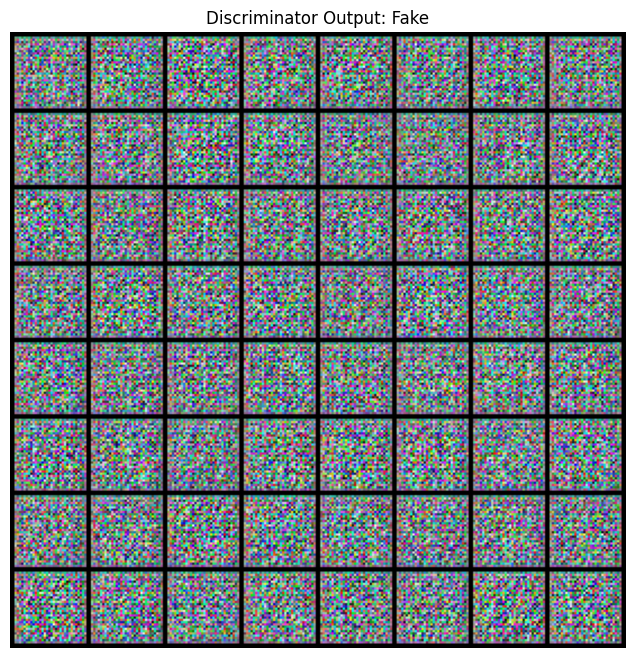

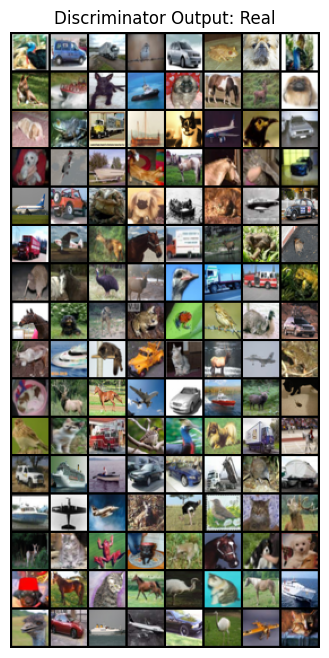

[0/5][200/391]	Loss_D: 1.2100	Loss_G: 0.8564	D(x): 0.5412	D(G(z)): 0.4338 / 0.4324


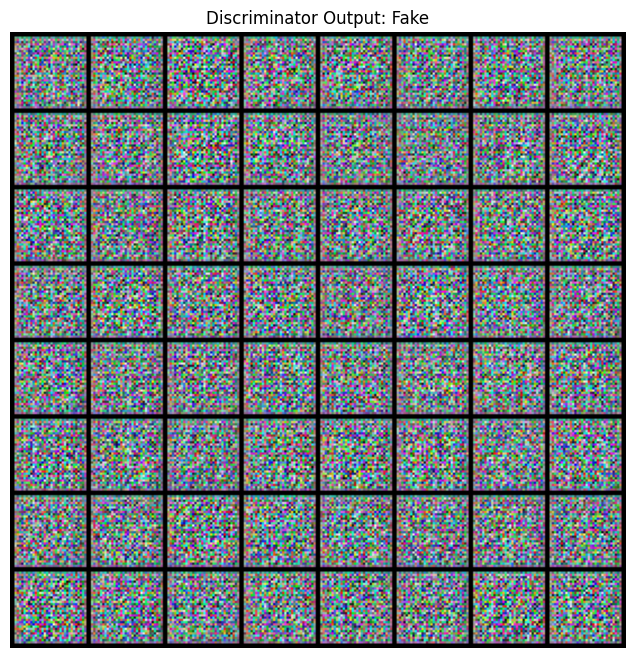

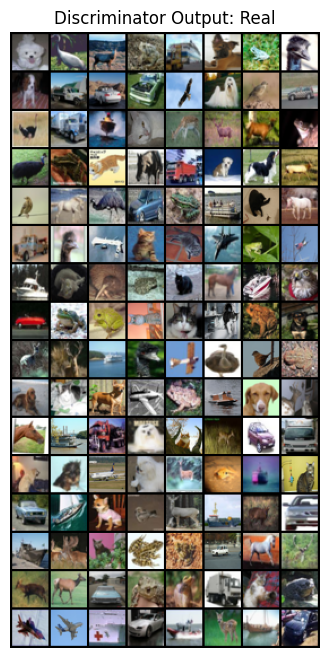

[0/5][300/391]	Loss_D: 1.0987	Loss_G: 0.9347	D(x): 0.5714	D(G(z)): 0.4023 / 0.4010


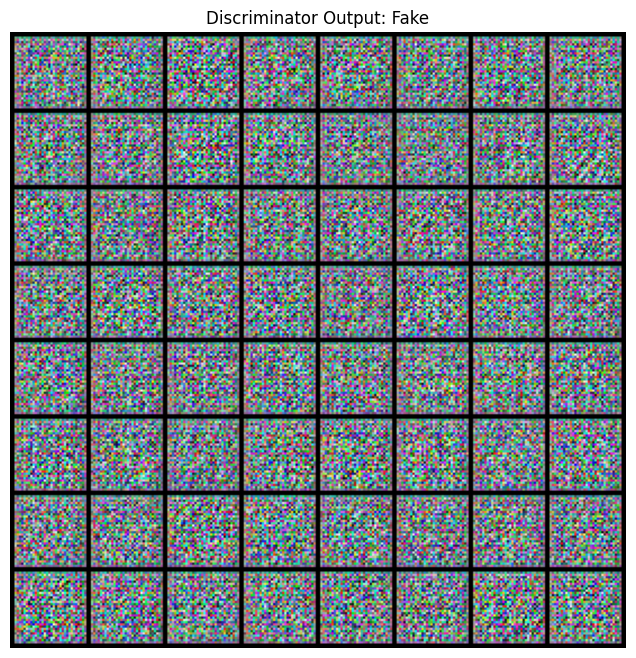

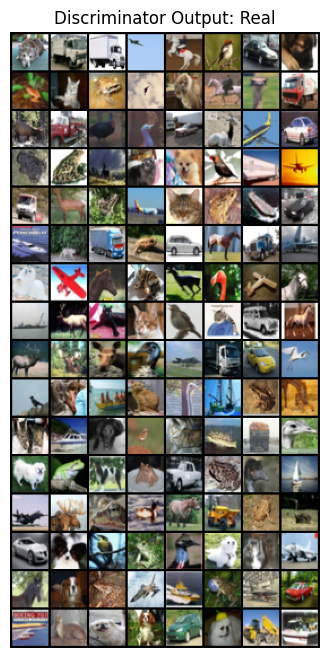

[1/5][0/391]	Loss_D: 1.0297	Loss_G: 0.9520	D(x): 0.6024	D(G(z)): 0.3939 / 0.3927


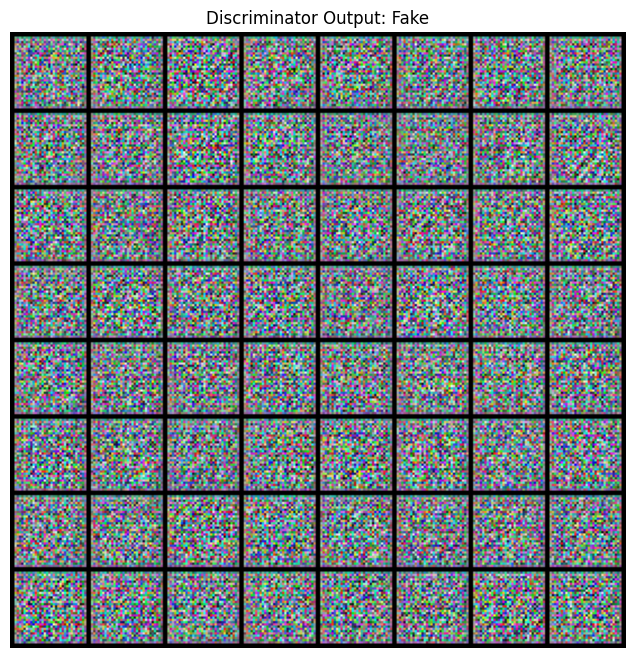

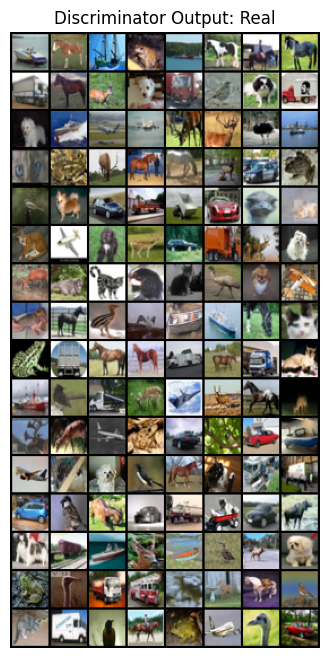

[1/5][100/391]	Loss_D: 0.9945	Loss_G: 0.9619	D(x): 0.6234	D(G(z)): 0.3906 / 0.3893


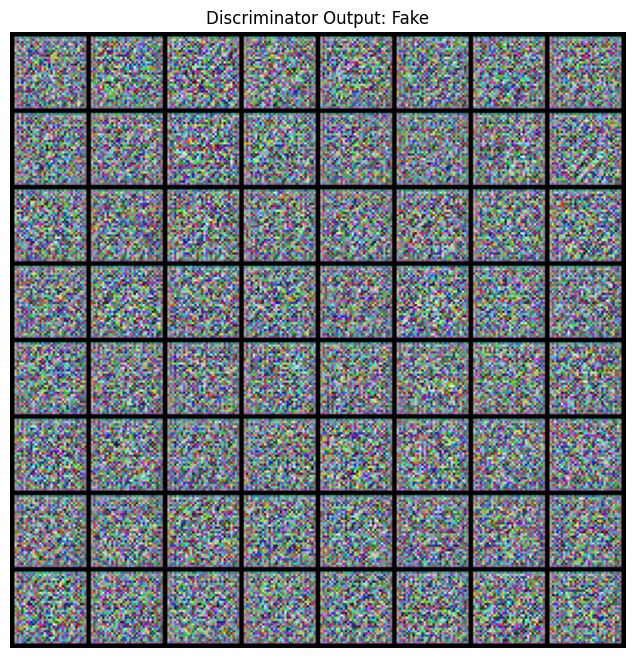

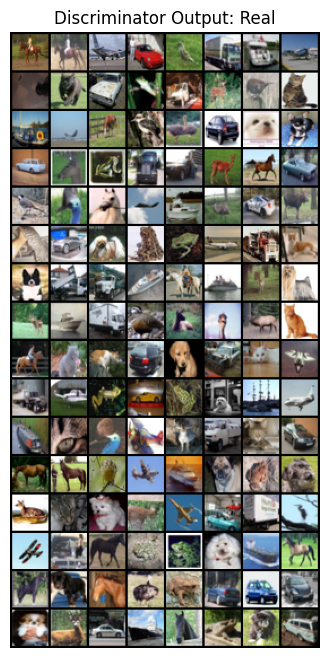

[1/5][200/391]	Loss_D: 0.9018	Loss_G: 1.0382	D(x): 0.6524	D(G(z)): 0.3629 / 0.3616


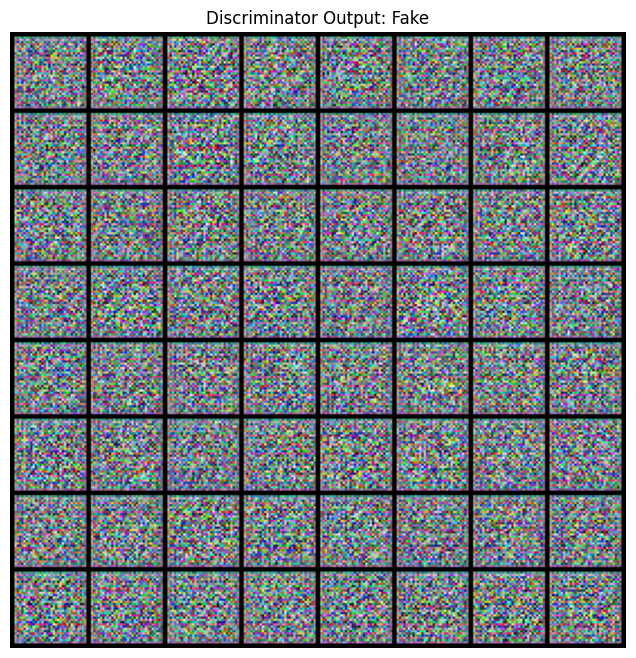

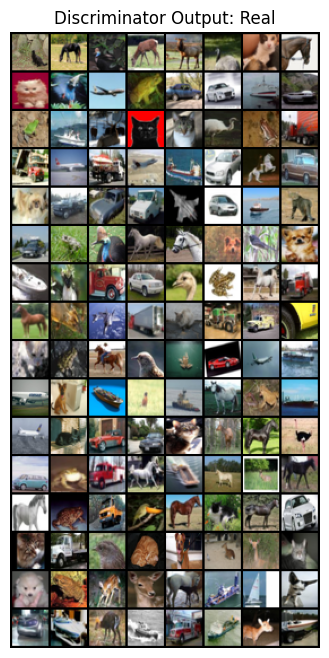

[1/5][300/391]	Loss_D: 0.8673	Loss_G: 1.0661	D(x): 0.6617	D(G(z)): 0.3515 / 0.3502


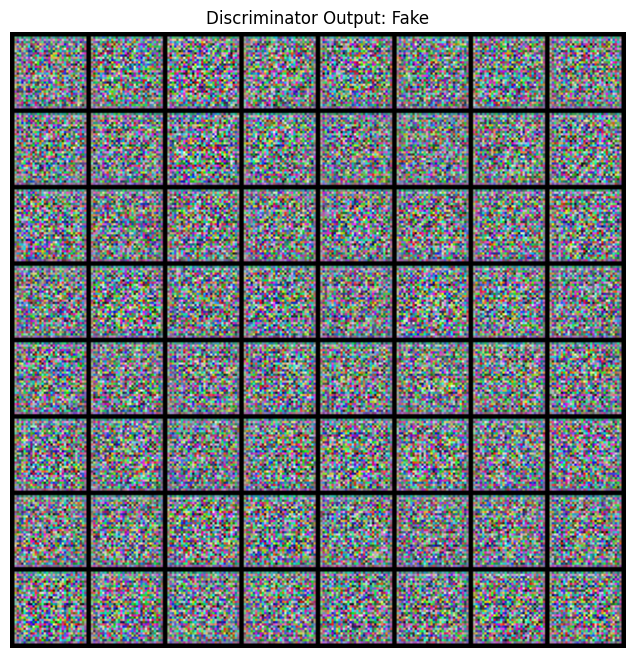

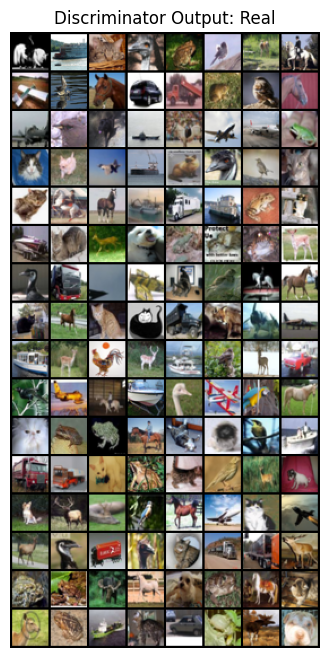

[2/5][0/391]	Loss_D: 0.8205	Loss_G: 1.1082	D(x): 0.6810	D(G(z)): 0.3391 / 0.3378


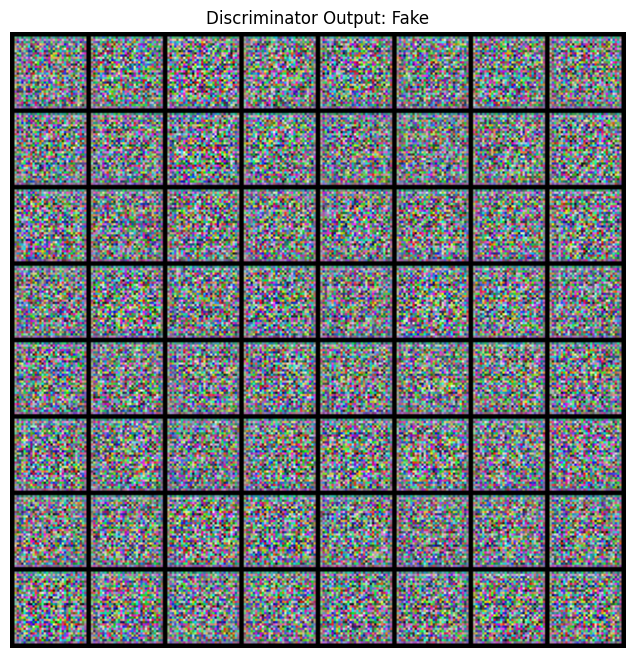

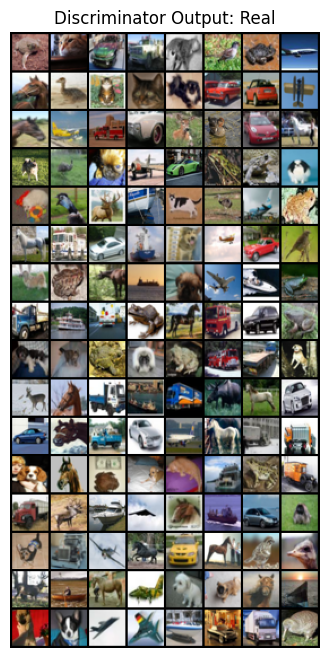

[2/5][100/391]	Loss_D: 0.7793	Loss_G: 1.1527	D(x): 0.6942	D(G(z)): 0.3226 / 0.3214


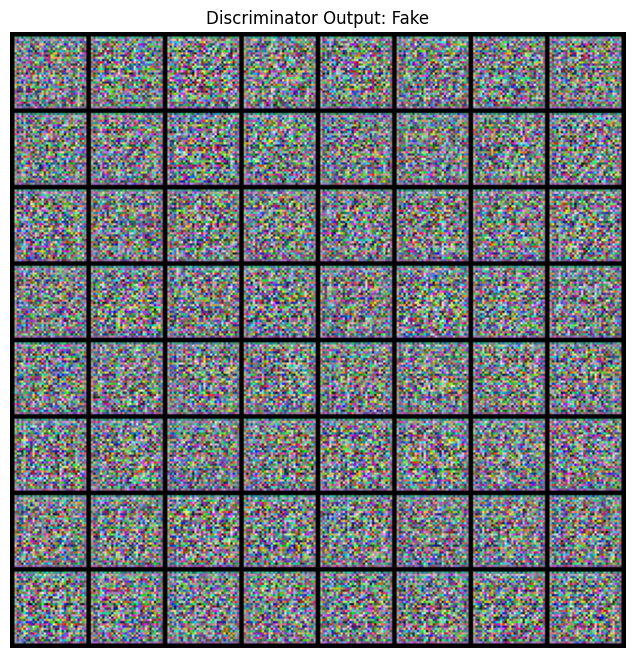

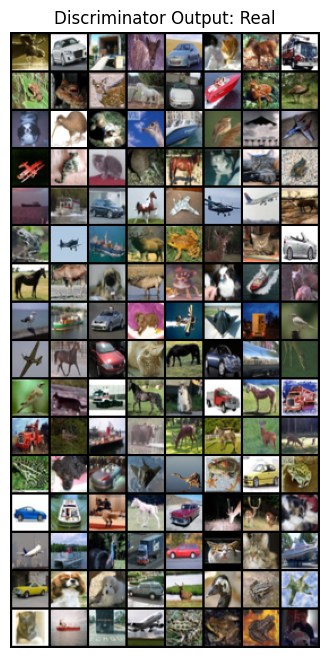

[2/5][200/391]	Loss_D: 0.7532	Loss_G: 1.1779	D(x): 0.7017	D(G(z)): 0.3159 / 0.3147


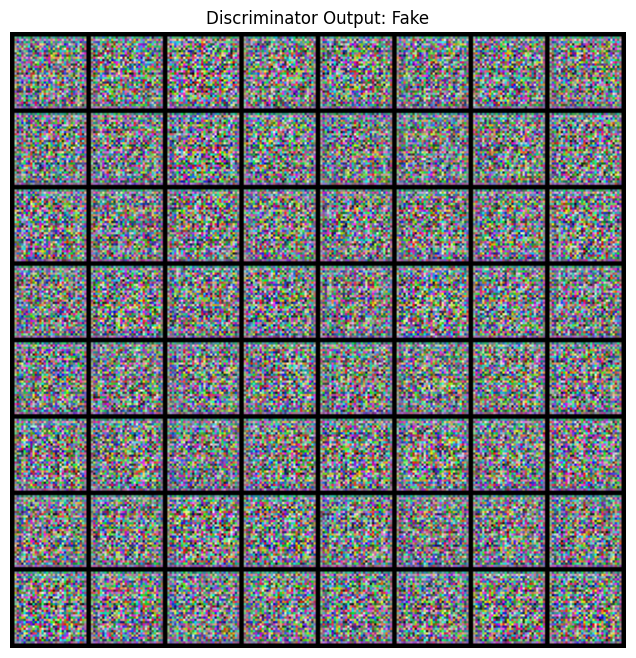

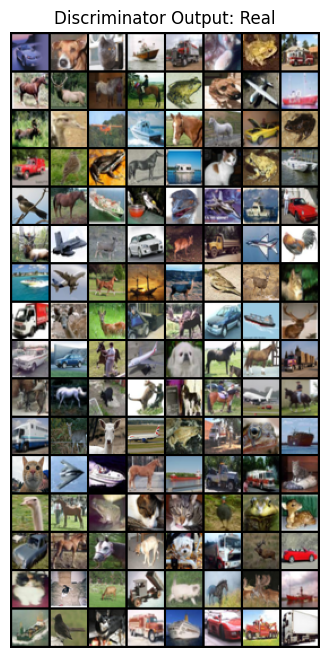

In [ ]:
import torch
import torchvision.utils as vutils
import matplotlib.pyplot as plt
num_epochs=5
save_path = './models'


# Define the function to plot images and discriminator output
def plot_images(images, real_fake):
    fig = plt.figure(figsize=(8, 8))
    plt.axis("off")
    plt.title(f"Discriminator Output: {real_fake}")
    plt.imshow(np.transpose(vutils.make_grid(images, padding=2, normalize=True).cpu(), (1, 2, 0)))
    plt.show()

# Training Loop
for epoch in range(num_epochs):
    for i, data in enumerate(train_dataloader, 0):
        # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        netD.zero_grad()

        # Train with real data
        real_data = data[0].to(device)
        b_size = real_data.size(0)
        label = torch.full((b_size,), 1, device=device)
        output = netD(real_data).view(-1)
        errD_real = criterion(output, label.float())
        errD_real.backward()
        D_x = output.mean().item()

        # Train with fake data
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(0)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label.float())
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        # Compute total loss and update D
        errD = errD_real + errD_fake
        optimizerD.step()

        # Update G network: maximize log(D(G(z)))
        netG.zero_grad()
        label.fill_(1)
        output = netD(fake).view(-1)
        errG = criterion(output, label.float())
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Print statistics
        if i % 100 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save generated images for every 100th iteration
        if i % 100 == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
                plot_images(fake, "Fake")
                
            real = real_data.cpu()
            plot_images(real, "Real")

    # Save the model checkpoints after every epoch
    if (epoch+1) % 100 == 0:
        torch.save(netG.state_dict(), f'{save_path}/netG_epoch_{epoch+1}.pth')
        torch.save(netD.state_dict(), f'{save_path}/netD_epoch_{epoch+1}.pth')
